In [1]:
import thinkplot
import scipy.fftpack
import numpy as np

from thinkdsp import decorate, UncorrelatedGaussianNoise, read_wave, Spectrogram
from scipy.stats import linregress

PI2 = np.pi * 2

# Exercise 1

In this chapter I claim that analyze1 takes time proportional to  n3  and analyze2 takes time proportional to  n2 . To see if that's true, run them on a range of input sizes and time them. In IPython, you can use the magic command %timeit.

In [2]:
signal = UncorrelatedGaussianNoise()
noise = signal.make_wave(duration=1.0, framerate=16384)
noise.ys.shape

(16384,)

In [3]:
ns = 2 ** np.arange(6, 13)
ns

array([  64,  128,  256,  512, 1024, 2048, 4096], dtype=int32)

In [4]:
def plot_bests(bests):    
    thinkplot.plot(ns, bests)
    thinkplot.config(xscale='log', yscale='log', legend=False)
    
    x = np.log(ns)
    y = np.log(bests)
    t = linregress(x,y)
    slope = t[0]

    return slope

In [5]:
def analyze1(ys, fs, ts):
    args = np.outer(ts, fs)
    M = np.cos(PI2 * args)
    amps = np.linalg.solve(M, ys)
    return amps

187 µs ± 0 ns per loop (mean ± std. dev. of 1 run, 10000 loops each)
582 µs ± 0 ns per loop (mean ± std. dev. of 1 run, 1000 loops each)
2.33 ms ± 0 ns per loop (mean ± std. dev. of 1 run, 100 loops each)
13.5 ms ± 0 ns per loop (mean ± std. dev. of 1 run, 100 loops each)
92.5 ms ± 0 ns per loop (mean ± std. dev. of 1 run, 10 loops each)
777 ms ± 0 ns per loop (mean ± std. dev. of 1 run, 1 loop each)
1.69 s ± 0 ns per loop (mean ± std. dev. of 1 run, 1 loop each)


2.3392318855013934

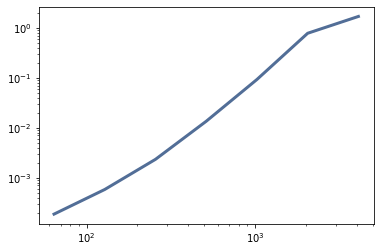

In [6]:
results = []
for N in ns:
    ts = (0.5 + np.arange(N)) / N
    freqs = (0.5 + np.arange(N)) / 2
    ys = noise.ys[:N]
    result = %timeit -r1 -o analyze1(ys, freqs, ts)
    results.append(result)
    
bests = [result.best for result in results]
plot_bests(bests)


In [7]:
def analyze2(ys, fs, ts):
    args = np.outer(ts, fs)
    M = np.cos(PI2 * args)
    amps = np.dot(M, ys) / 2
    return amps

101 µs ± 0 ns per loop (mean ± std. dev. of 1 run, 10000 loops each)
449 µs ± 0 ns per loop (mean ± std. dev. of 1 run, 1000 loops each)
2.42 ms ± 0 ns per loop (mean ± std. dev. of 1 run, 100 loops each)
6.25 ms ± 0 ns per loop (mean ± std. dev. of 1 run, 100 loops each)
21.7 ms ± 0 ns per loop (mean ± std. dev. of 1 run, 10 loops each)
115 ms ± 0 ns per loop (mean ± std. dev. of 1 run, 10 loops each)
449 ms ± 0 ns per loop (mean ± std. dev. of 1 run, 1 loop each)


1.9818566192221578

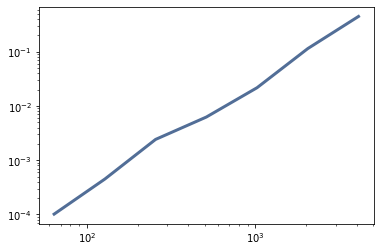

In [8]:
results = []
for N in ns:
    ts = (0.5 + np.arange(N)) / N
    freqs = (0.5 + np.arange(N)) / 2
    ys = noise.ys[:N]
    result = %timeit -r1 -o analyze2(ys, freqs, ts)
    results.append(result)
    
bests2 = [result.best for result in results]
plot_bests(bests2)

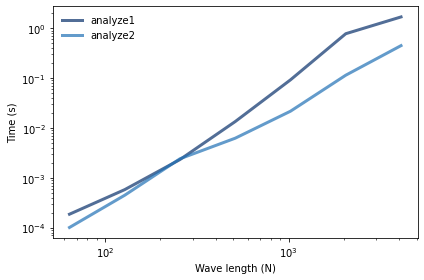

In [9]:
thinkplot.plot(ns, bests, label='analyze1')
thinkplot.plot(ns, bests2, label='analyze2')
decorate(xlabel='Wave length (N)', ylabel='Time (s)', **dict(xscale='log', yscale='log'))

# Exercise 2

One of the major applications of the DCT is compression for both sound and images. In its simplest form, DCT-based compression works like this:

Break a long signal into segments.

Compute the DCT of each segment.

Identify frequency components with amplitudes so low they are inaudible, and remove them. Store only the frequencies and amplitudes that remain.

To play back the signal, load the frequencies and amplitudes for each segment and apply the inverse DCT.

Implement a version of this algorithm and apply it to a recording of music or speech. How many components can you eliminate before the difference is perceptible?

In [10]:
wave = read_wave('412171__screamstudio__air-raid-siren-alarm.wav')
wave.make_audio()

In [11]:
segment = wave.segment(start=5, duration=0.5)
segment.normalize()
segment.make_audio()

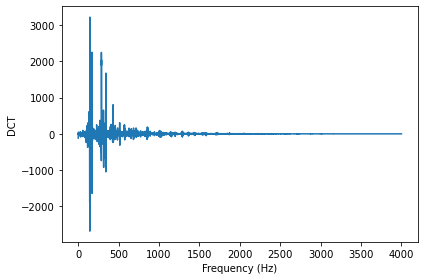

In [12]:
seg_dct = segment.make_dct()
seg_dct.plot(high=4000)
decorate(xlabel='Frequency (Hz)', ylabel='DCT')

In [13]:
def compress(dct, thresh=1):
    count = 0
    for i, amp in enumerate(dct.amps):
        if np.abs(amp) < thresh:
            dct.hs[i] = 0
            count += 1
            
    n = len(dct.amps)
    print(count, n, 100 * count / n, sep='\t')

20236	22050	91.77324263038548


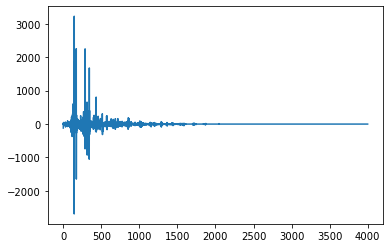

In [14]:
seg_dct = segment.make_dct()
compress(seg_dct, thresh=10)
seg_dct.plot(high=4000)

In [15]:
seg2 = seg_dct.make_wave()
seg2.make_audio()

In [16]:
def make_dct_spectrogram(wave, seg_length):
    window = np.hamming(seg_length)
    i, j = 0, seg_length
    step = seg_length // 2
    spec_map = {}

    while j < len(wave.ys):
        segment = wave.slice(i, j)
        segment.window(window)

        t = (segment.start + segment.end) / 2
        spec_map[t] = segment.make_dct()

        i += step
        j += step

    return Spectrogram(spec_map, seg_length)

In [17]:
spectro = make_dct_spectrogram(wave, seg_length=1024)
for t, dct in sorted(spectro.spec_map.items()):
    compress(dct, thresh=0.2)

1016	1024	99.21875
1010	1024	98.6328125
1007	1024	98.33984375
1002	1024	97.8515625
1001	1024	97.75390625
991	1024	96.77734375
983	1024	95.99609375
984	1024	96.09375
982	1024	95.8984375
988	1024	96.484375
970	1024	94.7265625
972	1024	94.921875
969	1024	94.62890625
968	1024	94.53125
971	1024	94.82421875
971	1024	94.82421875
968	1024	94.53125
963	1024	94.04296875
950	1024	92.7734375
958	1024	93.5546875
956	1024	93.359375
952	1024	92.96875
954	1024	93.1640625
942	1024	91.9921875
933	1024	91.11328125
937	1024	91.50390625
944	1024	92.1875
937	1024	91.50390625
931	1024	90.91796875
924	1024	90.234375
936	1024	91.40625
935	1024	91.30859375
931	1024	90.91796875
919	1024	89.74609375
927	1024	90.52734375
933	1024	91.11328125
931	1024	90.91796875
931	1024	90.91796875
930	1024	90.8203125
926	1024	90.4296875
928	1024	90.625
933	1024	91.11328125
915	1024	89.35546875
911	1024	88.96484375
921	1024	89.94140625
913	1024	89.16015625
919	1024	89.74609375
911	1024	88.96484375
928	1024	90.625
925	1024	90.3320

849	1024	82.91015625
847	1024	82.71484375
851	1024	83.10546875
843	1024	82.32421875
854	1024	83.3984375
844	1024	82.421875
837	1024	81.73828125
845	1024	82.51953125
838	1024	81.8359375
839	1024	81.93359375
841	1024	82.12890625
844	1024	82.421875
849	1024	82.91015625
853	1024	83.30078125
848	1024	82.8125
833	1024	81.34765625
846	1024	82.6171875
836	1024	81.640625
840	1024	82.03125
841	1024	82.12890625
845	1024	82.51953125
856	1024	83.59375
851	1024	83.10546875
839	1024	81.93359375
842	1024	82.2265625
848	1024	82.8125
847	1024	82.71484375
858	1024	83.7890625
857	1024	83.69140625
844	1024	82.421875
844	1024	82.421875
851	1024	83.10546875
847	1024	82.71484375
847	1024	82.71484375
847	1024	82.71484375
845	1024	82.51953125
852	1024	83.203125
838	1024	81.8359375
848	1024	82.8125
849	1024	82.91015625
843	1024	82.32421875
860	1024	83.984375
842	1024	82.2265625
856	1024	83.59375
852	1024	83.203125
848	1024	82.8125
846	1024	82.6171875
843	1024	82.32421875
853	1024	83.30078125
842	1024	82.2265625


854	1024	83.3984375
860	1024	83.984375
855	1024	83.49609375
862	1024	84.1796875
858	1024	83.7890625
851	1024	83.10546875
858	1024	83.7890625
862	1024	84.1796875
856	1024	83.59375
860	1024	83.984375
864	1024	84.375
866	1024	84.5703125
861	1024	84.08203125
856	1024	83.59375
847	1024	82.71484375
863	1024	84.27734375
851	1024	83.10546875
855	1024	83.49609375
866	1024	84.5703125
856	1024	83.59375
847	1024	82.71484375
857	1024	83.69140625
856	1024	83.59375
852	1024	83.203125
860	1024	83.984375
864	1024	84.375
854	1024	83.3984375
856	1024	83.59375
855	1024	83.49609375
855	1024	83.49609375
861	1024	84.08203125
855	1024	83.49609375
867	1024	84.66796875
858	1024	83.7890625
867	1024	84.66796875
857	1024	83.69140625
868	1024	84.765625
868	1024	84.765625
859	1024	83.88671875
865	1024	84.47265625
864	1024	84.375
865	1024	84.47265625
866	1024	84.5703125
863	1024	84.27734375
854	1024	83.3984375
861	1024	84.08203125
863	1024	84.27734375
856	1024	83.59375
859	1024	83.88671875
866	1024	84.5703125
854	102

857	1024	83.69140625
863	1024	84.27734375
869	1024	84.86328125
864	1024	84.375
864	1024	84.375
860	1024	83.984375
873	1024	85.25390625
861	1024	84.08203125
849	1024	82.91015625
856	1024	83.59375
858	1024	83.7890625
860	1024	83.984375
850	1024	83.0078125
864	1024	84.375
849	1024	82.91015625
858	1024	83.7890625
855	1024	83.49609375
862	1024	84.1796875
855	1024	83.49609375
859	1024	83.88671875
861	1024	84.08203125
865	1024	84.47265625
862	1024	84.1796875
865	1024	84.47265625
858	1024	83.7890625
862	1024	84.1796875
858	1024	83.7890625
860	1024	83.984375
864	1024	84.375
862	1024	84.1796875
867	1024	84.66796875
860	1024	83.984375
861	1024	84.08203125
848	1024	82.8125
853	1024	83.30078125
848	1024	82.8125
856	1024	83.59375
859	1024	83.88671875
860	1024	83.984375
852	1024	83.203125
860	1024	83.984375
835	1024	81.54296875
863	1024	84.27734375
846	1024	82.6171875
857	1024	83.69140625
855	1024	83.49609375
864	1024	84.375
854	1024	83.3984375
853	1024	83.30078125
858	1024	83.7890625
853	1024	83.300

849	1024	82.91015625
837	1024	81.73828125
837	1024	81.73828125
836	1024	81.640625
844	1024	82.421875
841	1024	82.12890625
849	1024	82.91015625
837	1024	81.73828125
828	1024	80.859375
831	1024	81.15234375
845	1024	82.51953125
836	1024	81.640625
848	1024	82.8125
831	1024	81.15234375
847	1024	82.71484375
839	1024	81.93359375
835	1024	81.54296875
841	1024	82.12890625
839	1024	81.93359375
846	1024	82.6171875
840	1024	82.03125
844	1024	82.421875
840	1024	82.03125
849	1024	82.91015625
854	1024	83.3984375
849	1024	82.91015625
848	1024	82.8125
844	1024	82.421875
842	1024	82.2265625
841	1024	82.12890625
849	1024	82.91015625
844	1024	82.421875
835	1024	81.54296875
832	1024	81.25
826	1024	80.6640625
845	1024	82.51953125
834	1024	81.4453125
846	1024	82.6171875
847	1024	82.71484375
835	1024	81.54296875
844	1024	82.421875
849	1024	82.91015625
847	1024	82.71484375
844	1024	82.421875
841	1024	82.12890625
829	1024	80.95703125
844	1024	82.421875
831	1024	81.15234375
851	1024	83.10546875
832	1024	81.25
84

884	1024	86.328125
903	1024	88.18359375
891	1024	87.01171875
887	1024	86.62109375
896	1024	87.5
901	1024	87.98828125
895	1024	87.40234375
892	1024	87.109375
897	1024	87.59765625
899	1024	87.79296875
894	1024	87.3046875
896	1024	87.5
892	1024	87.109375
896	1024	87.5
894	1024	87.3046875
893	1024	87.20703125
900	1024	87.890625
891	1024	87.01171875
895	1024	87.40234375
892	1024	87.109375
893	1024	87.20703125
891	1024	87.01171875
894	1024	87.3046875
901	1024	87.98828125
894	1024	87.3046875
899	1024	87.79296875
906	1024	88.4765625
899	1024	87.79296875
898	1024	87.6953125
894	1024	87.3046875
896	1024	87.5
900	1024	87.890625
899	1024	87.79296875
889	1024	86.81640625
896	1024	87.5
888	1024	86.71875
896	1024	87.5
891	1024	87.01171875
888	1024	86.71875
902	1024	88.0859375
902	1024	88.0859375
905	1024	88.37890625
899	1024	87.79296875
896	1024	87.5
904	1024	88.28125
899	1024	87.79296875
895	1024	87.40234375
907	1024	88.57421875
896	1024	87.5
897	1024	87.59765625
897	1024	87.59765625
901	1024	87.988

828	1024	80.859375
834	1024	81.4453125
844	1024	82.421875
846	1024	82.6171875
846	1024	82.6171875
831	1024	81.15234375
831	1024	81.15234375
837	1024	81.73828125
846	1024	82.6171875
851	1024	83.10546875
831	1024	81.15234375
829	1024	80.95703125
834	1024	81.4453125
821	1024	80.17578125
838	1024	81.8359375
841	1024	82.12890625
843	1024	82.32421875
836	1024	81.640625
844	1024	82.421875
836	1024	81.640625
849	1024	82.91015625
842	1024	82.2265625
839	1024	81.93359375
851	1024	83.10546875
833	1024	81.34765625
836	1024	81.640625
834	1024	81.4453125
840	1024	82.03125
831	1024	81.15234375
835	1024	81.54296875
842	1024	82.2265625
826	1024	80.6640625
840	1024	82.03125
851	1024	83.10546875
847	1024	82.71484375
835	1024	81.54296875
839	1024	81.93359375
838	1024	81.8359375
830	1024	81.0546875
836	1024	81.640625
842	1024	82.2265625
834	1024	81.4453125
834	1024	81.4453125
844	1024	82.421875
844	1024	82.421875
835	1024	81.54296875
840	1024	82.03125
837	1024	81.73828125
835	1024	81.54296875
826	1024	80.6

840	1024	82.03125
846	1024	82.6171875
840	1024	82.03125
825	1024	80.56640625
841	1024	82.12890625
831	1024	81.15234375
839	1024	81.93359375
836	1024	81.640625
839	1024	81.93359375
843	1024	82.32421875
829	1024	80.95703125
832	1024	81.25
838	1024	81.8359375
841	1024	82.12890625
841	1024	82.12890625
858	1024	83.7890625
849	1024	82.91015625
843	1024	82.32421875
837	1024	81.73828125
837	1024	81.73828125
833	1024	81.34765625
845	1024	82.51953125
845	1024	82.51953125
833	1024	81.34765625
842	1024	82.2265625
844	1024	82.421875
839	1024	81.93359375
850	1024	83.0078125
838	1024	81.8359375
849	1024	82.91015625
843	1024	82.32421875
843	1024	82.32421875
843	1024	82.32421875
838	1024	81.8359375
836	1024	81.640625
840	1024	82.03125
836	1024	81.640625
843	1024	82.32421875
853	1024	83.30078125
848	1024	82.8125
843	1024	82.32421875
849	1024	82.91015625
842	1024	82.2265625
841	1024	82.12890625
837	1024	81.73828125
846	1024	82.6171875
849	1024	82.91015625
842	1024	82.2265625
844	1024	82.421875
846	1024	8

891	1024	87.01171875
882	1024	86.1328125
875	1024	85.44921875
886	1024	86.5234375
880	1024	85.9375
895	1024	87.40234375
880	1024	85.9375
875	1024	85.44921875
879	1024	85.83984375
868	1024	84.765625
873	1024	85.25390625
867	1024	84.66796875
872	1024	85.15625
865	1024	84.47265625
883	1024	86.23046875
863	1024	84.27734375
875	1024	85.44921875
870	1024	84.9609375
862	1024	84.1796875
867	1024	84.66796875
856	1024	83.59375
874	1024	85.3515625
873	1024	85.25390625
862	1024	84.1796875
863	1024	84.27734375
877	1024	85.64453125
867	1024	84.66796875
873	1024	85.25390625
868	1024	84.765625
869	1024	84.86328125
867	1024	84.66796875
869	1024	84.86328125
872	1024	85.15625
866	1024	84.5703125
875	1024	85.44921875
878	1024	85.7421875
867	1024	84.66796875
871	1024	85.05859375
876	1024	85.546875
866	1024	84.5703125
878	1024	85.7421875
861	1024	84.08203125
871	1024	85.05859375
858	1024	83.7890625
867	1024	84.66796875
875	1024	85.44921875
866	1024	84.5703125
872	1024	85.15625
867	1024	84.66796875
875	1024	

838	1024	81.8359375
852	1024	83.203125
849	1024	82.91015625
829	1024	80.95703125
837	1024	81.73828125
842	1024	82.2265625
843	1024	82.32421875
836	1024	81.640625
847	1024	82.71484375
837	1024	81.73828125
840	1024	82.03125
842	1024	82.2265625
839	1024	81.93359375
845	1024	82.51953125
848	1024	82.8125
841	1024	82.12890625
842	1024	82.2265625
835	1024	81.54296875
844	1024	82.421875
834	1024	81.4453125
839	1024	81.93359375
842	1024	82.2265625
848	1024	82.8125
848	1024	82.8125
848	1024	82.8125
845	1024	82.51953125
837	1024	81.73828125
842	1024	82.2265625
841	1024	82.12890625
841	1024	82.12890625
843	1024	82.32421875
836	1024	81.640625
841	1024	82.12890625
838	1024	81.8359375
841	1024	82.12890625
842	1024	82.2265625
843	1024	82.32421875
833	1024	81.34765625
846	1024	82.6171875
834	1024	81.4453125
852	1024	83.203125
838	1024	81.8359375
843	1024	82.32421875
842	1024	82.2265625
835	1024	81.54296875
841	1024	82.12890625
842	1024	82.2265625
837	1024	81.73828125
838	1024	81.8359375
836	1024	81.640

881	1024	86.03515625
880	1024	85.9375
878	1024	85.7421875
868	1024	84.765625
885	1024	86.42578125
877	1024	85.64453125
880	1024	85.9375
884	1024	86.328125
886	1024	86.5234375
884	1024	86.328125
892	1024	87.109375
890	1024	86.9140625
887	1024	86.62109375
891	1024	87.01171875
890	1024	86.9140625
891	1024	87.01171875
883	1024	86.23046875
883	1024	86.23046875
894	1024	87.3046875
896	1024	87.5
889	1024	86.81640625
896	1024	87.5
882	1024	86.1328125
889	1024	86.81640625
883	1024	86.23046875
892	1024	87.109375
890	1024	86.9140625
876	1024	85.546875
897	1024	87.59765625
899	1024	87.79296875
884	1024	86.328125
892	1024	87.109375
887	1024	86.62109375
884	1024	86.328125
887	1024	86.62109375
892	1024	87.109375
889	1024	86.81640625
898	1024	87.6953125
890	1024	86.9140625
883	1024	86.23046875
889	1024	86.81640625
889	1024	86.81640625
898	1024	87.6953125
901	1024	87.98828125
891	1024	87.01171875
894	1024	87.3046875
905	1024	88.37890625
892	1024	87.109375
888	1024	86.71875
897	1024	87.59765625
891	1024

823	1024	80.37109375
841	1024	82.12890625
836	1024	81.640625
844	1024	82.421875
831	1024	81.15234375
826	1024	80.6640625
832	1024	81.25
828	1024	80.859375
839	1024	81.93359375
827	1024	80.76171875
828	1024	80.859375
823	1024	80.37109375
831	1024	81.15234375
823	1024	80.37109375
824	1024	80.46875
835	1024	81.54296875
825	1024	80.56640625
820	1024	80.078125
843	1024	82.32421875
834	1024	81.4453125
820	1024	80.078125
834	1024	81.4453125
838	1024	81.8359375
837	1024	81.73828125
837	1024	81.73828125
837	1024	81.73828125
834	1024	81.4453125
835	1024	81.54296875
844	1024	82.421875
830	1024	81.0546875
832	1024	81.25
831	1024	81.15234375
838	1024	81.8359375
832	1024	81.25
823	1024	80.37109375
837	1024	81.73828125
825	1024	80.56640625
843	1024	82.32421875
852	1024	83.203125
845	1024	82.51953125
829	1024	80.95703125
842	1024	82.2265625
842	1024	82.2265625
841	1024	82.12890625
831	1024	81.15234375
832	1024	81.25
837	1024	81.73828125
830	1024	81.0546875
827	1024	80.76171875
837	1024	81.73828125
828

830	1024	81.0546875
842	1024	82.2265625
832	1024	81.25
835	1024	81.54296875
839	1024	81.93359375
839	1024	81.93359375
844	1024	82.421875
845	1024	82.51953125
842	1024	82.2265625
842	1024	82.2265625
839	1024	81.93359375
844	1024	82.421875
827	1024	80.76171875
842	1024	82.2265625
839	1024	81.93359375
848	1024	82.8125
830	1024	81.0546875
832	1024	81.25
837	1024	81.73828125
834	1024	81.4453125
836	1024	81.640625
839	1024	81.93359375
850	1024	83.0078125
834	1024	81.4453125
848	1024	82.8125
848	1024	82.8125
839	1024	81.93359375
842	1024	82.2265625
831	1024	81.15234375
843	1024	82.32421875
842	1024	82.2265625
847	1024	82.71484375
837	1024	81.73828125
835	1024	81.54296875
851	1024	83.10546875
842	1024	82.2265625
850	1024	83.0078125
845	1024	82.51953125
846	1024	82.6171875
844	1024	82.421875
846	1024	82.6171875
845	1024	82.51953125
843	1024	82.32421875
839	1024	81.93359375
851	1024	83.10546875
851	1024	83.10546875
850	1024	83.0078125
855	1024	83.49609375
855	1024	83.49609375
849	1024	82.9101562

879	1024	85.83984375
866	1024	84.5703125
881	1024	86.03515625
865	1024	84.47265625
871	1024	85.05859375
879	1024	85.83984375
861	1024	84.08203125
873	1024	85.25390625
873	1024	85.25390625
877	1024	85.64453125
882	1024	86.1328125
864	1024	84.375
869	1024	84.86328125
862	1024	84.1796875
869	1024	84.86328125
867	1024	84.66796875
864	1024	84.375
871	1024	85.05859375
866	1024	84.5703125
869	1024	84.86328125
872	1024	85.15625
858	1024	83.7890625
864	1024	84.375
864	1024	84.375
870	1024	84.9609375
861	1024	84.08203125
857	1024	83.69140625
863	1024	84.27734375
858	1024	83.7890625
863	1024	84.27734375
846	1024	82.6171875
854	1024	83.3984375
850	1024	83.0078125
860	1024	83.984375
871	1024	85.05859375
850	1024	83.0078125
863	1024	84.27734375
857	1024	83.69140625
864	1024	84.375
852	1024	83.203125
848	1024	82.8125
850	1024	83.0078125
847	1024	82.71484375
848	1024	82.8125
855	1024	83.49609375
856	1024	83.59375
846	1024	82.6171875
857	1024	83.69140625
861	1024	84.08203125
862	1024	84.1796875
861	102

845	1024	82.51953125
851	1024	83.10546875
837	1024	81.73828125
839	1024	81.93359375
858	1024	83.7890625
838	1024	81.8359375
854	1024	83.3984375
843	1024	82.32421875
841	1024	82.12890625
835	1024	81.54296875
839	1024	81.93359375
841	1024	82.12890625
842	1024	82.2265625
839	1024	81.93359375
841	1024	82.12890625
845	1024	82.51953125
838	1024	81.8359375
838	1024	81.8359375
854	1024	83.3984375
829	1024	80.95703125
838	1024	81.8359375
841	1024	82.12890625
825	1024	80.56640625
847	1024	82.71484375
835	1024	81.54296875
840	1024	82.03125
844	1024	82.421875
842	1024	82.2265625
837	1024	81.73828125
854	1024	83.3984375
854	1024	83.3984375
840	1024	82.03125
840	1024	82.03125
842	1024	82.2265625
836	1024	81.640625
837	1024	81.73828125
830	1024	81.0546875
841	1024	82.12890625
844	1024	82.421875
850	1024	83.0078125
839	1024	81.93359375
843	1024	82.32421875
849	1024	82.91015625
831	1024	81.15234375
825	1024	80.56640625
834	1024	81.4453125
846	1024	82.6171875
839	1024	81.93359375
843	1024	82.32421875
83

889	1024	86.81640625
884	1024	86.328125
888	1024	86.71875
889	1024	86.81640625
886	1024	86.5234375
888	1024	86.71875
891	1024	87.01171875
889	1024	86.81640625
877	1024	85.64453125
887	1024	86.62109375
879	1024	85.83984375
882	1024	86.1328125
886	1024	86.5234375
877	1024	85.64453125
892	1024	87.109375
877	1024	85.64453125
897	1024	87.59765625
895	1024	87.40234375
874	1024	85.3515625
895	1024	87.40234375
897	1024	87.59765625
886	1024	86.5234375
889	1024	86.81640625
890	1024	86.9140625
883	1024	86.23046875
901	1024	87.98828125
896	1024	87.5
889	1024	86.81640625
900	1024	87.890625
888	1024	86.71875
885	1024	86.42578125
894	1024	87.3046875
880	1024	85.9375
888	1024	86.71875
890	1024	86.9140625
891	1024	87.01171875
890	1024	86.9140625
898	1024	87.6953125
895	1024	87.40234375
892	1024	87.109375
889	1024	86.81640625
890	1024	86.9140625
892	1024	87.109375
886	1024	86.5234375
896	1024	87.5
885	1024	86.42578125
900	1024	87.890625
894	1024	87.3046875
894	1024	87.3046875
890	1024	86.9140625
900	102

846	1024	82.6171875
847	1024	82.71484375
832	1024	81.25
832	1024	81.25
836	1024	81.640625
837	1024	81.73828125
829	1024	80.95703125
831	1024	81.15234375
832	1024	81.25
847	1024	82.71484375
841	1024	82.12890625
846	1024	82.6171875
841	1024	82.12890625
840	1024	82.03125
836	1024	81.640625
847	1024	82.71484375
840	1024	82.03125
835	1024	81.54296875
844	1024	82.421875
829	1024	80.95703125
843	1024	82.32421875
841	1024	82.12890625
826	1024	80.6640625
840	1024	82.03125
846	1024	82.6171875
828	1024	80.859375
833	1024	81.34765625
840	1024	82.03125
844	1024	82.421875
836	1024	81.640625
845	1024	82.51953125
844	1024	82.421875
831	1024	81.15234375
838	1024	81.8359375
852	1024	83.203125
842	1024	82.2265625
848	1024	82.8125
853	1024	83.30078125
855	1024	83.49609375
849	1024	82.91015625
842	1024	82.2265625
848	1024	82.8125
851	1024	83.10546875
850	1024	83.0078125
830	1024	81.0546875
831	1024	81.15234375
843	1024	82.32421875
837	1024	81.73828125
847	1024	82.71484375
841	1024	82.12890625
848	1024	82.8

835	1024	81.54296875
843	1024	82.32421875
835	1024	81.54296875
838	1024	81.8359375
847	1024	82.71484375
841	1024	82.12890625
842	1024	82.2265625
828	1024	80.859375
845	1024	82.51953125
839	1024	81.93359375
838	1024	81.8359375
844	1024	82.421875
846	1024	82.6171875
832	1024	81.25
846	1024	82.6171875
855	1024	83.49609375
845	1024	82.51953125
844	1024	82.421875
834	1024	81.4453125
848	1024	82.8125
839	1024	81.93359375
844	1024	82.421875
834	1024	81.4453125
846	1024	82.6171875
844	1024	82.421875
844	1024	82.421875
847	1024	82.71484375
831	1024	81.15234375
843	1024	82.32421875
830	1024	81.0546875
842	1024	82.2265625
845	1024	82.51953125
837	1024	81.73828125
833	1024	81.34765625
839	1024	81.93359375
837	1024	81.73828125
836	1024	81.640625
847	1024	82.71484375
848	1024	82.8125
849	1024	82.91015625
844	1024	82.421875
846	1024	82.6171875
854	1024	83.3984375
854	1024	83.3984375
849	1024	82.91015625
855	1024	83.49609375
849	1024	82.91015625
845	1024	82.51953125
843	1024	82.32421875
847	1024	82.71

909	1024	88.76953125
899	1024	87.79296875
908	1024	88.671875
909	1024	88.76953125
901	1024	87.98828125
903	1024	88.18359375
916	1024	89.453125
898	1024	87.6953125
909	1024	88.76953125
904	1024	88.28125
893	1024	87.20703125
885	1024	86.42578125
897	1024	87.59765625
912	1024	89.0625
911	1024	88.96484375
877	1024	85.64453125
915	1024	89.35546875
888	1024	86.71875
885	1024	86.42578125
899	1024	87.79296875
910	1024	88.8671875
898	1024	87.6953125
901	1024	87.98828125
897	1024	87.59765625
895	1024	87.40234375
894	1024	87.3046875
892	1024	87.109375
895	1024	87.40234375
881	1024	86.03515625
890	1024	86.9140625
891	1024	87.01171875
896	1024	87.5
905	1024	88.37890625
884	1024	86.328125
891	1024	87.01171875
899	1024	87.79296875
893	1024	87.20703125
884	1024	86.328125
894	1024	87.3046875
899	1024	87.79296875
880	1024	85.9375
900	1024	87.890625
890	1024	86.9140625
890	1024	86.9140625
898	1024	87.6953125
883	1024	86.23046875
877	1024	85.64453125
890	1024	86.9140625
887	1024	86.62109375
884	1024	86.32

851	1024	83.10546875
840	1024	82.03125
845	1024	82.51953125
854	1024	83.3984375
841	1024	82.12890625
844	1024	82.421875
844	1024	82.421875
840	1024	82.03125
848	1024	82.8125
845	1024	82.51953125
837	1024	81.73828125
836	1024	81.640625
840	1024	82.03125
843	1024	82.32421875
839	1024	81.93359375
832	1024	81.25
836	1024	81.640625
836	1024	81.640625
850	1024	83.0078125
845	1024	82.51953125
846	1024	82.6171875
840	1024	82.03125
845	1024	82.51953125
840	1024	82.03125
833	1024	81.34765625
834	1024	81.4453125
840	1024	82.03125
825	1024	80.56640625
836	1024	81.640625
842	1024	82.2265625
836	1024	81.640625
848	1024	82.8125
834	1024	81.4453125
842	1024	82.2265625
849	1024	82.91015625
838	1024	81.8359375
842	1024	82.2265625
850	1024	83.0078125
842	1024	82.2265625
852	1024	83.203125
856	1024	83.59375
846	1024	82.6171875
844	1024	82.421875
844	1024	82.421875
845	1024	82.51953125
859	1024	83.88671875
854	1024	83.3984375
848	1024	82.8125
847	1024	82.71484375
842	1024	82.2265625
860	1024	83.984375
833	

883	1024	86.23046875
896	1024	87.5
878	1024	85.7421875
886	1024	86.5234375
885	1024	86.42578125
875	1024	85.44921875
873	1024	85.25390625
882	1024	86.1328125
869	1024	84.86328125
883	1024	86.23046875
901	1024	87.98828125
879	1024	85.83984375
888	1024	86.71875
889	1024	86.81640625
889	1024	86.81640625
898	1024	87.6953125
870	1024	84.9609375
887	1024	86.62109375
894	1024	87.3046875
885	1024	86.42578125
886	1024	86.5234375
892	1024	87.109375
886	1024	86.5234375
886	1024	86.5234375
891	1024	87.01171875
900	1024	87.890625
889	1024	86.81640625
893	1024	87.20703125
903	1024	88.18359375
895	1024	87.40234375
888	1024	86.71875
891	1024	87.01171875
898	1024	87.6953125
892	1024	87.109375
894	1024	87.3046875
895	1024	87.40234375
887	1024	86.62109375
893	1024	87.20703125
891	1024	87.01171875
891	1024	87.01171875
900	1024	87.890625
898	1024	87.6953125
897	1024	87.59765625
898	1024	87.6953125
891	1024	87.01171875
903	1024	88.18359375
897	1024	87.59765625
903	1024	88.18359375
899	1024	87.79296875
896	1

988	1024	96.484375
987	1024	96.38671875
996	1024	97.265625
983	1024	95.99609375
991	1024	96.77734375
990	1024	96.6796875
996	1024	97.265625
994	1024	97.0703125
997	1024	97.36328125
996	1024	97.265625
991	1024	96.77734375
996	1024	97.265625
994	1024	97.0703125
989	1024	96.58203125
991	1024	96.77734375
989	1024	96.58203125
997	1024	97.36328125
998	1024	97.4609375
998	1024	97.4609375
990	1024	96.6796875
994	1024	97.0703125
995	1024	97.16796875
992	1024	96.875
995	1024	97.16796875
990	1024	96.6796875
991	1024	96.77734375
990	1024	96.6796875
996	1024	97.265625
995	1024	97.16796875
993	1024	96.97265625
994	1024	97.0703125
1000	1024	97.65625
994	1024	97.0703125
995	1024	97.16796875
1000	1024	97.65625
992	1024	96.875
994	1024	97.0703125
999	1024	97.55859375
997	1024	97.36328125
997	1024	97.36328125
994	1024	97.0703125
997	1024	97.36328125
993	1024	96.97265625
999	1024	97.55859375
988	1024	96.484375
994	1024	97.0703125
994	1024	97.0703125
997	1024	97.36328125
996	1024	97.265625
1001	1024	97.753

1024	1024	100.0
1024	1024	100.0
1024	1024	100.0
1024	1024	100.0
1024	1024	100.0
1024	1024	100.0
1024	1024	100.0
1024	1024	100.0
1024	1024	100.0
1024	1024	100.0
1024	1024	100.0
1024	1024	100.0
1024	1024	100.0
1024	1024	100.0
1024	1024	100.0
1024	1024	100.0
1024	1024	100.0
1024	1024	100.0
1024	1024	100.0
1024	1024	100.0
1024	1024	100.0
1024	1024	100.0
1024	1024	100.0
1024	1024	100.0
1024	1024	100.0
1024	1024	100.0
1024	1024	100.0
1024	1024	100.0
1024	1024	100.0
1024	1024	100.0
1024	1024	100.0
1024	1024	100.0
1024	1024	100.0
1024	1024	100.0
1024	1024	100.0
1024	1024	100.0
1024	1024	100.0
1024	1024	100.0
1024	1024	100.0
1024	1024	100.0
1024	1024	100.0
1024	1024	100.0
1024	1024	100.0
1024	1024	100.0
1024	1024	100.0
1024	1024	100.0
1024	1024	100.0
1024	1024	100.0
1024	1024	100.0
1024	1024	100.0
1024	1024	100.0
1024	1024	100.0
1024	1024	100.0
1024	1024	100.0
1024	1024	100.0
1024	1024	100.0
1024	1024	100.0
1024	1024	100.0
1024	1024	100.0
1024	1024	100.0
1024	1024	100.0
1024	1024	100.0
1024	102

1024	1024	100.0
1024	1024	100.0
1024	1024	100.0
1024	1024	100.0
1024	1024	100.0
1024	1024	100.0
1024	1024	100.0
1024	1024	100.0
1024	1024	100.0
1024	1024	100.0
1024	1024	100.0
1024	1024	100.0
1024	1024	100.0
1024	1024	100.0
1024	1024	100.0
1024	1024	100.0
1024	1024	100.0
1024	1024	100.0
1024	1024	100.0
1024	1024	100.0
1024	1024	100.0


In [18]:
wave2 = spectro.make_wave()
wave2.make_audio()

In [19]:
wave.make_audio()

# Exercise 3

In [20]:
def plot_angle(spectrum, thresh=1):
    angles = spectrum.angles
    angles[spectrum.amps < thresh] = np.nan
    thinkplot.plot(spectrum.fs, angles, 'x')
    decorate(xlabel='Frequency (Hz)', ylabel='Phase (radian)')

In [21]:
def plot_three(spectrum, thresh=1):
    thinkplot.preplot(cols=3)
    spectrum.plot()
    thinkplot.subplot(2)
    plot_angle(spectrum, thresh=thresh)
    thinkplot.subplot(3)
    wave = spectrum.make_wave()
    wave.segment(duration=0.01).plot()
    wave.apodize()
    display(wave.make_audio())

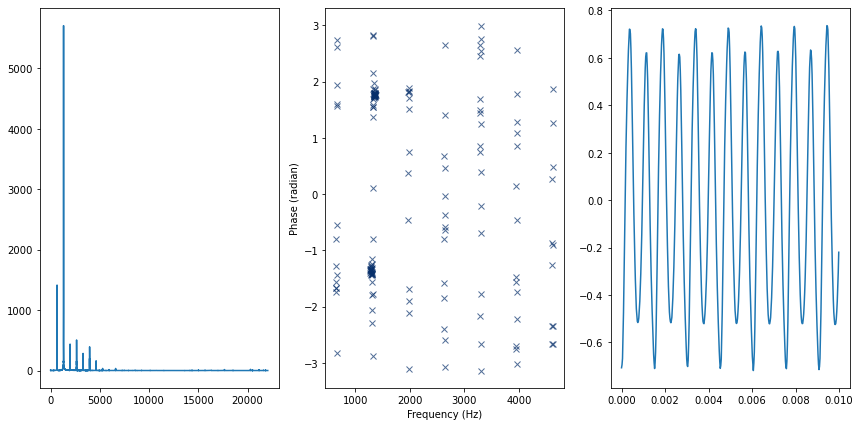

In [22]:
wave = read_wave('120994__thirsk__120-oboe.wav')
wave.make_audio()
segment = wave.segment(start=2.3, duration=0.7)

spectrum = segment.make_spectrum()
plot_three(spectrum, thresh=50)

In [23]:
def zero_angle(spectrum):
    res = spectrum.copy()
    res.hs = res.amps
    return res

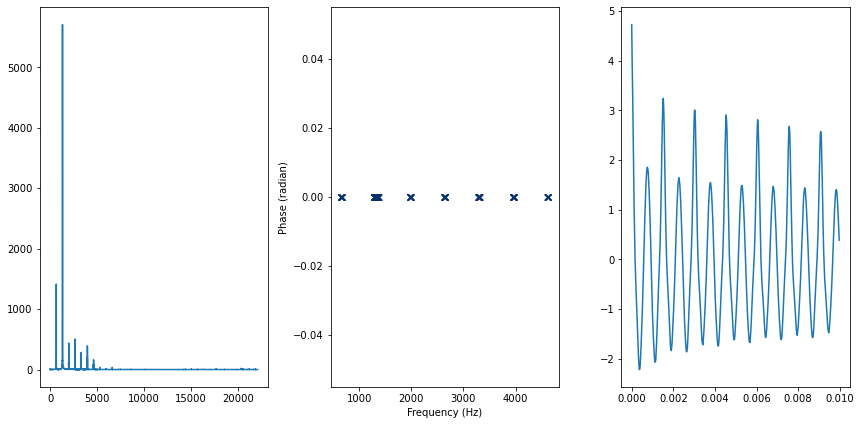

In [24]:
spectrum2 = zero_angle(spectrum)
plot_three(spectrum2, thresh=50)

In [25]:
def rotate_angle(spectrum, offset):
    res = spectrum.copy()
    res.hs *= np.exp(1j * offset)
    return res

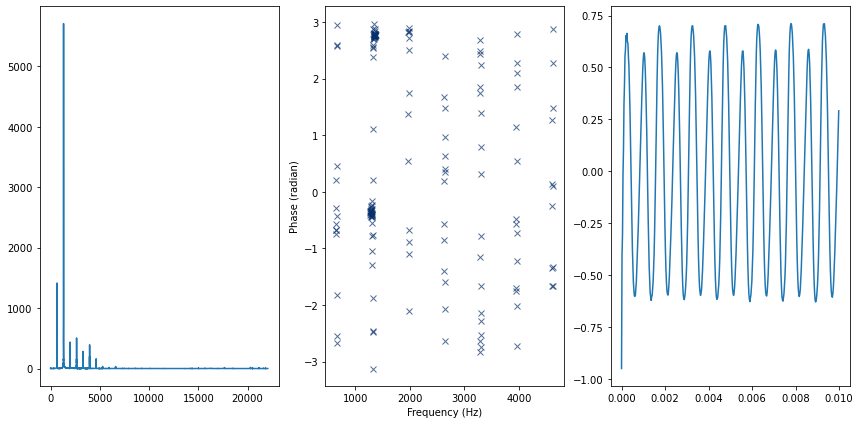

In [26]:
spectrum3 = rotate_angle(spectrum, 1)
plot_three(spectrum3, thresh=50)

In [27]:
def random_angle(spectrum):
    res = spectrum.copy()
    angles = np.random.uniform(0, PI2, len(spectrum))
    res.hs *= np.exp(1j * angles)
    return res

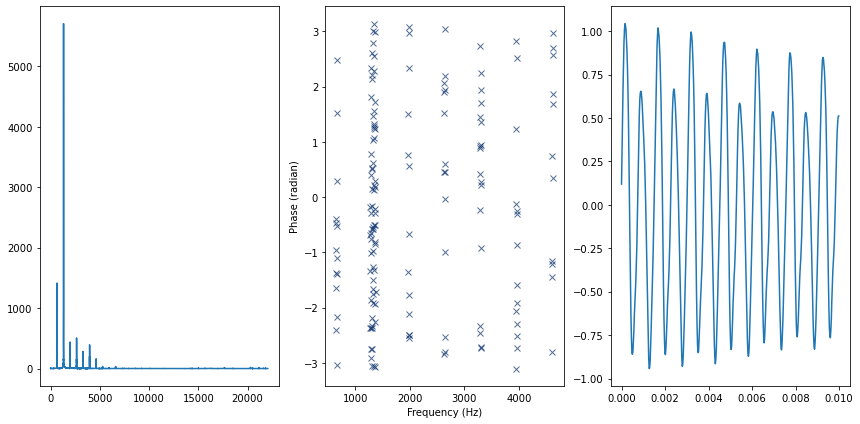

In [28]:
spectrum4 = random_angle(spectrum)
plot_three(spectrum4, thresh=50)